# Task 0. Preparation

Often, given a set of images, we are required to segment out regions/labels before further analysis of our data.

We are given 10 consecutive ‘axial’ cross-sections of a publicly available MRI of a single human subject and are required to segment out 5 tissue layers. Specifically, a single file, ‘Brain.mat’, which contains T1 weighted MRI images (each slice has a dimension of 362*434 pixel) with each z-slice being at 1 mm interval (spanning 10 mm). 

Additionally, we are given a ‘pre-segmented’ set of the same data GT to allow comparison and analysis (ground truth).

- Label 0 = air
- Label 1 = skin/scalp
- Label 2 = skull
- Label 3 = CSF
- Label 4 = Gray Matter
- Label 5 = White Matter

## 1. Install dependencies and import modules

In [1]:
import time
from scipy.io import loadmat
%matplotlib inline
from utils import *

## 2. Load the data

In [2]:
mri_data = loadmat('Brain.mat')
T1 = mri_data['T1'] # T1 original, np.array   
GT = mri_data['label'] # Ground truth (manual segmentation), np.array
T1.shape, GT.shape

((362, 434, 10), (362, 434, 10))

## 3. Visualise

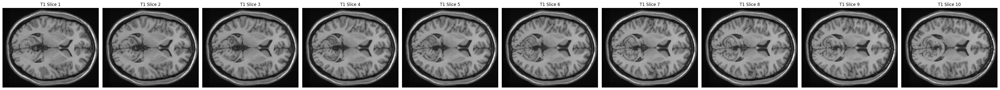

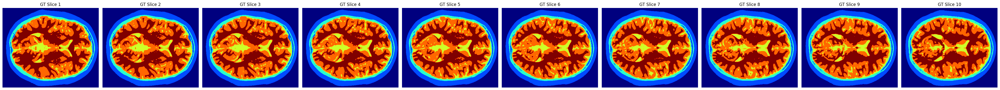

In [3]:
visualize_row(T1, cap='T1', cmap='gray')
visualize_row(GT, cap='GT')

# Task 1: 2D Tissue Segmentation

Develop several 2D-algorithms for brain MRI segmentation using traditional computer vision techniques.

*To test any approach, execute all common cells and specific ones, related to the particular approach, in sequential order.*

## Approach 1 (Morphological Chan Vese)

### Step 1: Separation of 0,1,2 and 3,4,5 regions

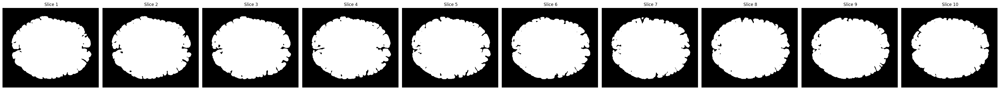

In [77]:
# Morphological Chan Vese with predefined settings to get the brain mask
T1_brain_mask = np.stack([chan_vese(T1[:, :, i])
                        for i in range(T1.shape[2])], axis=-1)

visualize_row(T1_brain_mask, cmap='gray')

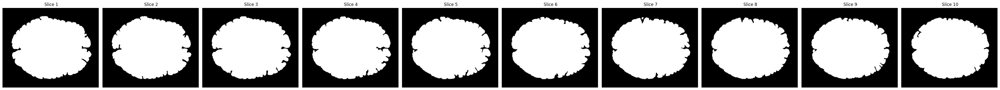

In [78]:
# Closing to close small cavities
T1_brain_mask = np.stack([close(T1_brain_mask[:, :, i])
                        for i in range(T1_brain_mask.shape[2])], axis=-1)
# Area Closing to get rid of some holes
T1_brain_mask = np.stack([area_close(T1_brain_mask[:, :, i], area_threshold=500)
                        for i in range(T1_brain_mask.shape[2])], axis=-1)

visualize_row(T1_brain_mask, cmap='gray')

In [79]:
# Blackout the brain region to isolate the non-brain region
T1_not_brain = blackout_pixels(T1, T1_brain_mask)
# Invert the brain mask to get the non-brain mask
T1_not_brain_mask = invert_binary(T1_brain_mask)
# Blackout the non-brain region to get the brain region
T1_brain = blackout_pixels(T1, T1_not_brain_mask)

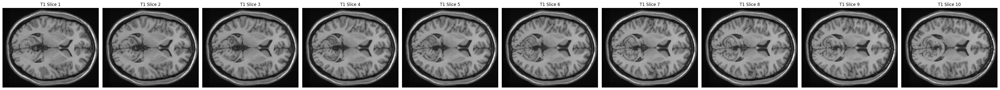

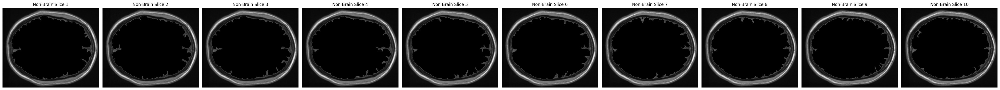

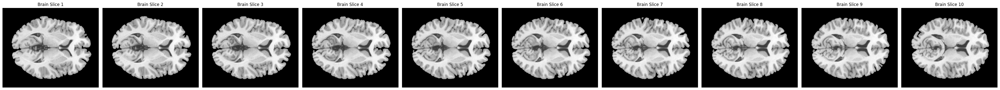

In [80]:
visualize_row(T1, cap='T1', cmap='gray')
visualize_row(T1_not_brain, cap='Non-Brain', cmap='gray')
visualize_row(T1_brain, cap='Brain', cmap='gray')

## Approach 2 & Approach 3 (Morphological Geodesic Active Contours)

### Step 1: Separation of 0,1,2 and 3,4,5 regions

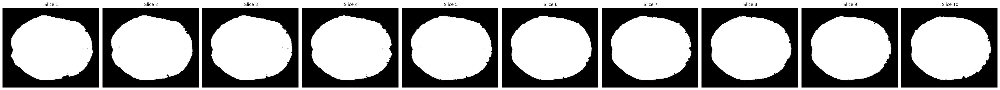

In [81]:
# Morphological Geodesic Active Contours with predefined settings to get the brain mask
T1_brain_mask = np.stack([geod_active_contour(T1[:, :, i])
                        for i in range(T1.shape[2])], axis=-1)

visualize_row(T1_brain_mask, cmap='gray')

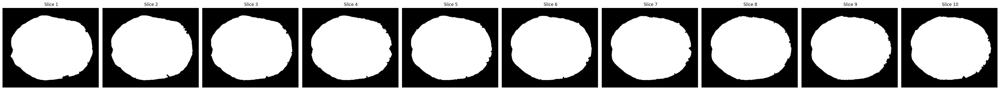

In [82]:
# Closing to close small cavities
T1_brain_mask = np.stack([close(T1_brain_mask[:, :, i])
                        for i in range(T1_brain_mask.shape[2])], axis=-1)
# Area Closing to get rid of some holes
T1_brain_mask = np.stack([area_close(T1_brain_mask[:, :, i], area_threshold=500)
                        for i in range(T1_brain_mask.shape[2])], axis=-1)

visualize_row(T1_brain_mask, cmap='gray')

In [83]:
# Blackout the brain region to isolate the non-brain region
T1_not_brain = blackout_pixels(T1, T1_brain_mask)
# Invert the brain mask to get the non-brain mask
T1_not_brain_mask = invert_binary(T1_brain_mask)
# Blackout the non-brain region to get the brain region
T1_brain = blackout_pixels(T1, T1_not_brain_mask)

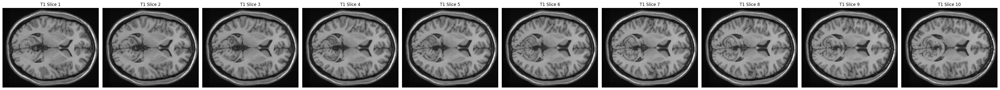

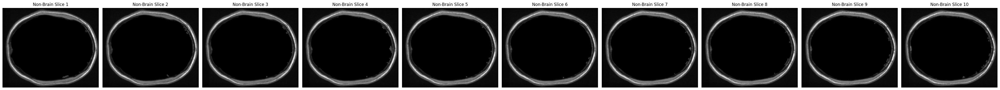

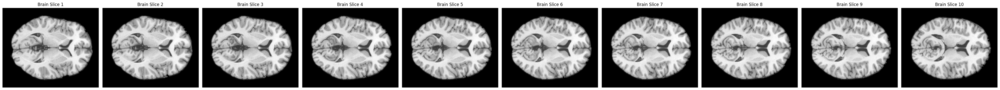

In [84]:
visualize_row(T1, cap='T1', cmap='gray')
visualize_row(T1_not_brain, cap='Non-Brain', cmap='gray')
visualize_row(T1_brain, cap='Brain', cmap='gray')

## Common (Otsu Thresholding)

### Step 2: Segmentation of 0,1,2 regions

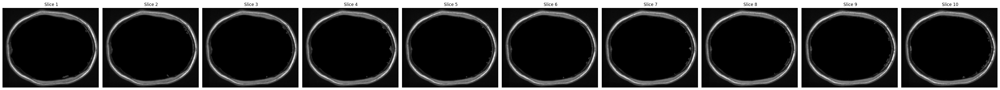

In [85]:
# What we are working with
visualize_row(T1_not_brain, cmap='gray')

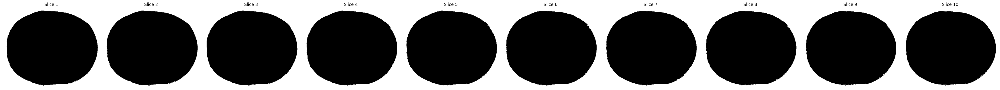

In [86]:
# Otsu Thresholding to get the binary mask of bright T1 regions
T1_0 = np.stack([multi_otsu_thresholding(T1[:, :, i], classes=2)
                        for i in range(T1.shape[2])], axis=-1)
# Area Closing to 3D volume to get the T1_0 mask (region 0)
T1_0 = np.stack([area_close(T1_0[:, :, i], area_threshold=20000)
                        for i in range(T1_0.shape[2])], axis=-1)
# Inverting (region of interest should be =1)
T1_0 = invert_binary(T1_0)
visualize_row(T1_0, cmap='gray')

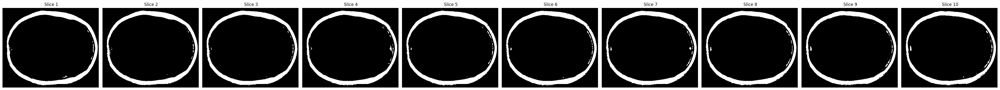

In [87]:
# The whiter regions in non-brain area mostly represent region 1
# Other whiter regions belong to the region 3 that MCV missed
# Otsu Thresholding to get T1_1 mask (region 1)
T1_1 = np.stack([multi_otsu_thresholding(T1_not_brain[:, :, i], classes=2)
                        for i in range(T1_not_brain.shape[2])], axis=-1)
# Combine T1_0 and T1_1 masks
T1_0_1 = T1_1 + T1_0
# Area Closing to get the refined T1_1 mask
T1_0_1 = np.stack([area_close(T1_0_1[:, :, i], area_threshold = 500)
                        for i in range(T1_0_1.shape[2])], axis=-1)
# Obtain clear T1_1
T1_1 = T1_0_1 - T1_0 #still contains small parts of region 3 (due to MCV)

visualize_row(T1_1, cmap='gray')

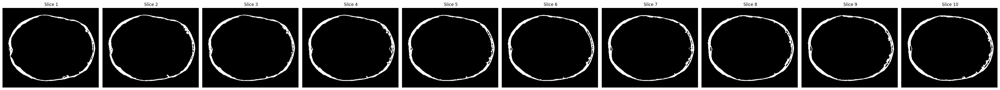

In [88]:
# Blackout T1_0 region in T1_not_brain
T1_1_2 = blackout_pixels(T1_not_brain, T1_0)
# Compute max intensity in T1_1_2
max_intensity = np.max(T1_1_2)
# Raise every !=0 pixel to that intensity
T1_1_2 = raise_nonblack_pixels(T1_1_2, max_intensity)
T1_1_2[T1_1_2 == max_intensity] = 1 #bring to {0,1}
# Obtain clear T1_2 mask (region 2)
T1_2 = T1_1_2 - T1_1

visualize_row(T1_2, cmap='gray')

## Approach 1 & Approach 2 (K-Means)

### Step 3: Segmentation of 3,4,5 regions

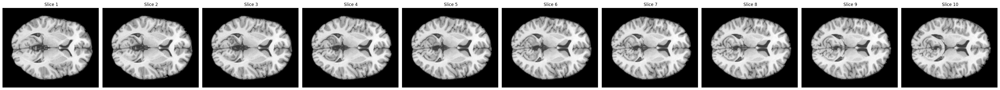

In [89]:
# What we are working with
visualize_row(T1_brain, cmap='gray')

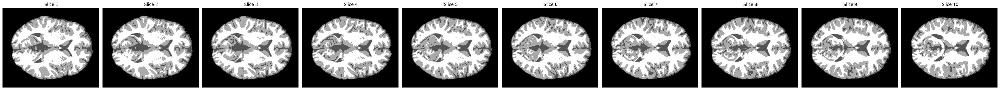

In [90]:
# K-Means to obtain four (three brain) regions: non-brain (black), 3, 4, 5
T1_3_4_5 = np.stack([kmeans_segmentation(T1_brain[:, :, i], 4)
                        for i in range(T1_brain.shape[2])], axis=-1)

visualize_row(T1_3_4_5, cmap='gray')

In [ ]:
# Obtain region masks
T1_3_4_5_labels = np.unique(T1_3_4_5)[1:]

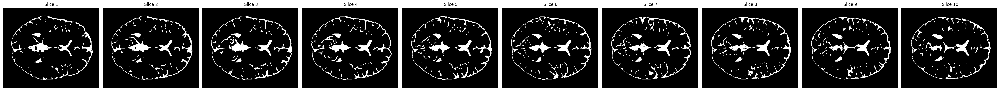

In [92]:
# Get the T1_3 mask (region 3)
T1_3 = (T1_3_4_5 == T1_3_4_5_labels[0]).astype(np.float32)

visualize_row(T1_3, cmap='gray')

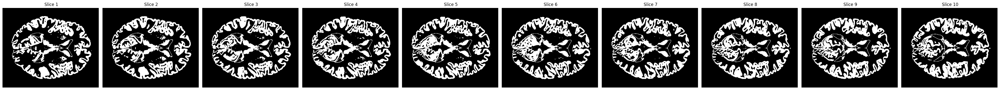

In [93]:
# Get the T1_4 mask (region 4)
T1_4 = (T1_3_4_5 == T1_3_4_5_labels[1]).astype(np.float32)

visualize_row(T1_4, cmap='gray')

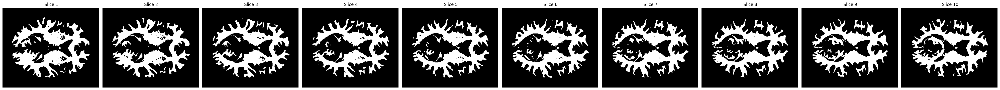

In [94]:
# Get the T1_5 mask (region 5)
T1_5 = (T1_3_4_5 == T1_3_4_5_labels[2]).astype(np.float32)

visualize_row(T1_5, cmap='gray')

## Approach 3 (Multi-Otsu Thresholding)

### Step 3: Segmentation of 3,4,5 regions

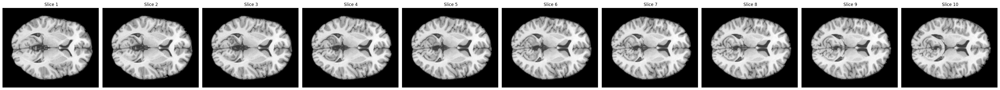

In [95]:
# What we are working with
visualize_row(T1_brain, cmap='gray')

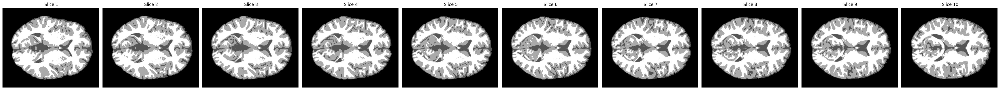

In [96]:
# Multi-Otsu Thresholding to obtain four (three brain) regions: non-brain (black), 3, 4, 5
T1_3_4_5 = np.stack([multi_otsu_thresholding(T1_brain[:, :, i], classes=4)
                        for i in range(T1_brain.shape[2])], axis=-1)

visualize_row(T1_3_4_5, cmap='gray')

In [97]:
# Obtain region masks
T1_3_4_5_labels = np.unique(T1_3_4_5)[1:]

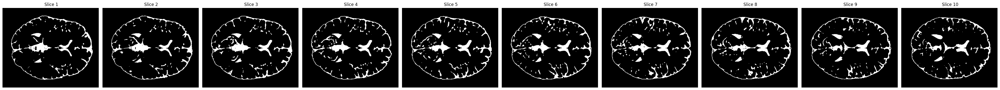

In [98]:
# Get the T1_3 mask (region 3)
T1_3 = (T1_3_4_5 == T1_3_4_5_labels[0]).astype(np.float32)

visualize_row(T1_3, cmap='gray')

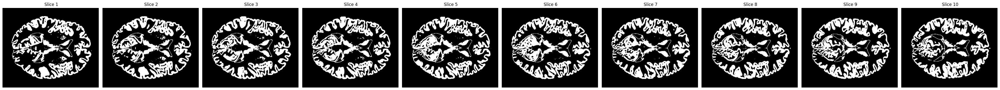

In [99]:
# Get the T1_4 mask (region 4)
T1_4 = (T1_3_4_5 == T1_3_4_5_labels[1]).astype(np.float32)

visualize_row(T1_4, cmap='gray')

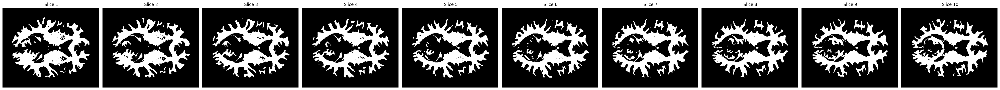

In [100]:
T1_5 = (T1_3_4_5 == T1_3_4_5_labels[2]).astype(np.float32)

visualize_row(T1_5, cmap='gray')

## Common (Combination)

### Step 4: Combination of segmented 0,1,2,3,4,5 regions

In [101]:
# Example: Approach 3
# Combine the obtained regions 0, 1, 2, 3, 4, 5
T1_0_1_2_3_4_5_A3 = combine_regions(T1_0, T1_1, T1_2, T1_3, T1_4, T1_5)

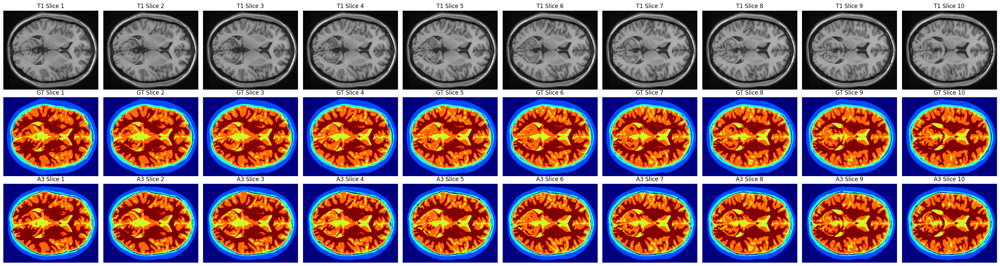

In [102]:
# Example: Approach 3
visualize_rows(T1, GT, T1_0_1_2_3_4_5_A3, 
               cap_1='T1',
               cap_2='GT',
               cap_3='A3',
               cmap_1='gray')

# Task 3: Advanced 3D Tissue Segmentation

Adapt best algorithms from 2D brain MRI segmentation task to 3D brain MRI segmentation problem where they are applied to all slices, simultaneously. 

*To test any approach, execute all common cells and specific ones, related to the particular approach, in sequential order.*

## Common 3D (Morphological Geodesic Active Contours + Otsu Thresholding)

### Step 1: Separation of 0,1,2 and 3,4,5 regions

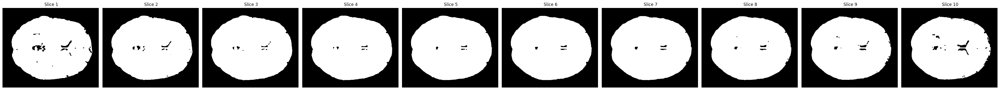

In [103]:
# Morphological Geodesic Active Contours with predefined settings to 3D volume to get the brain mask
T1_brain_mask = geod_active_contour(T1)
visualize_row(T1_brain_mask, cmap='gray')

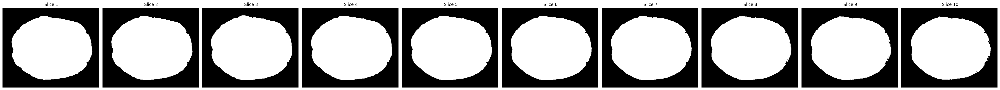

In [ ]:
# Closin to 3D volume to close small cavities (as before)
T1_brain_mask = close(T1_brain_mask)
# Area Closing to 3D volume to get rid of some holes (as before)
T1_brain_mask = area_close(T1_brain_mask, area_threshold=500*10) #since we have volume 10x
visualize_row(T1_brain_mask, cmap='gray')

In [105]:
# Blackout the brain region to isolate the non-brain region
T1_not_brain = blackout_pixels(T1, T1_brain_mask)
# Invert the brain mask to get the non-brain mask
T1_not_brain_mask = invert_binary(T1_brain_mask)
# Blackout the non-brain region to get the brain region
T1_brain = blackout_pixels(T1, T1_not_brain_mask)

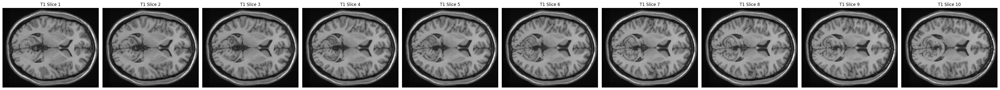

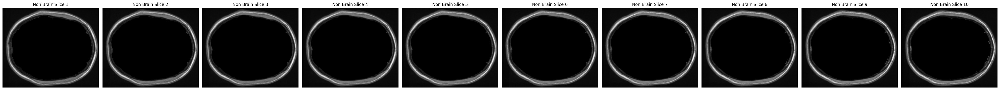

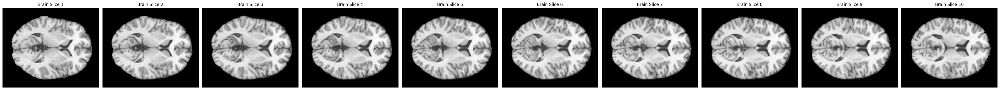

In [106]:
visualize_row(T1, cap='T1', cmap='gray')
visualize_row(T1_not_brain, cap='Non-Brain', cmap='gray')
visualize_row(T1_brain, cap='Brain', cmap='gray')

### Step 2: Segmentation of 0,1,2 regions

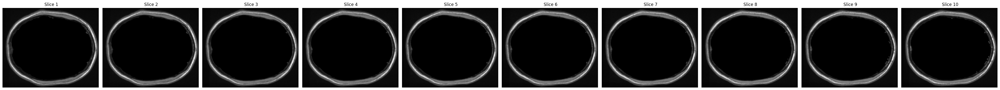

In [107]:
# What we are working with
visualize_row(T1_not_brain, cmap='gray')

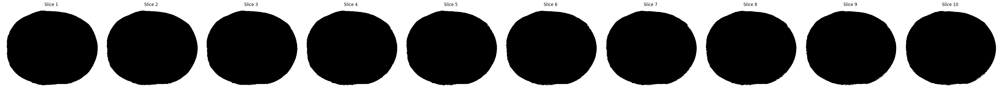

In [108]:
# Otsu Thresholding to 3D volume to get the mask of bright T1 regions
T1_0 = multi_otsu_thresholding(T1, classes=2)
# Area closing to 3D volume to get the T1_0 mask (region 0)
T1_0 = area_close(T1_0, area_threshold=20000*10)
# Inverting (region of interest should be =1)
T1_0 = invert_binary(T1_0)
visualize_row(T1_0, cmap='gray')

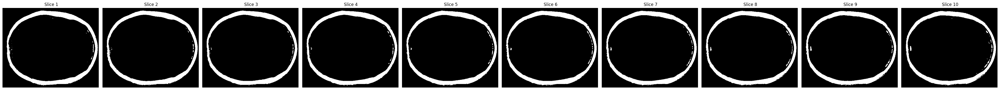

In [109]:
# Multi-Otsu Thresholding to 3D volume to get initial T1_1 mask (region 1)
T1_1 = multi_otsu_thresholding(T1_not_brain, classes=2)
# Combine T1_0 and T1_1 masks
T1_0_1 = T1_0 + T1_1
# Area Closing to 3D volume to get the refined T1_1 mask
T1_0_1 = area_close(T1_0_1, area_threshold = 500*10) #necessary to obtain refined T1_2 mask further
# Obtain clear T1_1
T1_1 = T1_0_1 - T1_0
visualize_row(T1_1, cmap='gray')

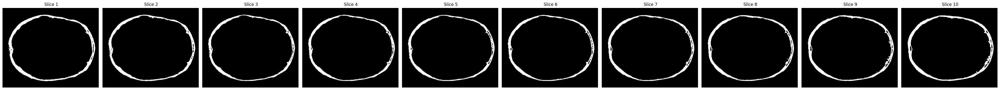

In [110]:
# Blackout T1_0 region in T1_not_brain
T1_1_2 = blackout_pixels(T1_not_brain, T1_0)
# Compute max intensity in T1_1_2
max_intensity = np.max(T1_1_2)
# Raise every !=0 pixel to that intensity
T1_1_2 = raise_nonblack_pixels(T1_1_2, max_intensity)
T1_1_2[T1_1_2 == max_intensity] = 1 #bring to {0,1}
# Obtain clear T1_2 mask (region 2)
T1_2 = T1_1_2 - T1_1
visualize_row(T1_2, cmap='gray')

## Approach 2 3D (K-Means)

### Step 3: Segmentation of 3,4,5 regions

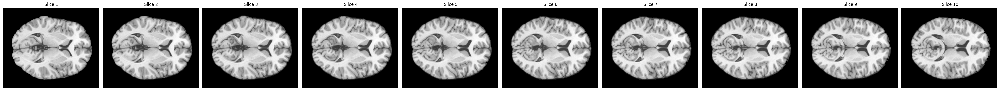

In [111]:
# What we are working with
visualize_row(T1_brain, cmap='gray')

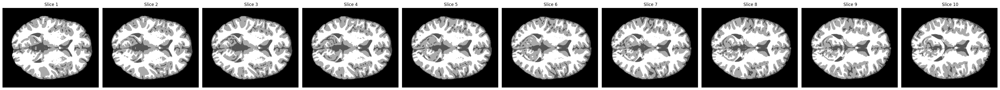

In [ ]:
# Multi-Otsu Thresholding to 3D volume to obtain four (three brain) regions: non-brain (black), 3, 4, 5
T1_3_4_5 = kmeans_segmentation(T1_brain, 4)
visualize_row(T1_3_4_5, cmap='gray')

In [113]:
# Obtain region masks
T1_3_4_5_labels = np.unique(T1_3_4_5)[1:]

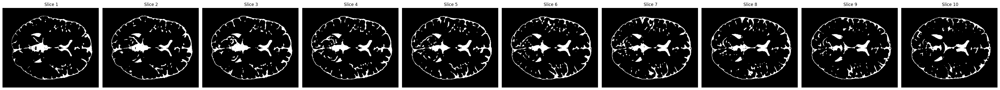

In [114]:
# Get the T1_3 mask (region 3)
T1_3 = (T1_3_4_5 == T1_3_4_5_labels[0]).astype(np.float32)
visualize_row(T1_3, cmap='gray')

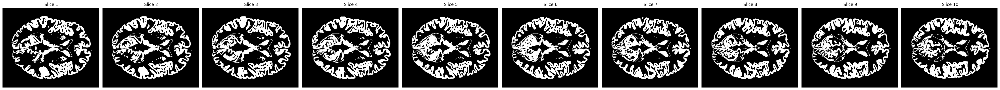

In [115]:
# Get the T1_4 mask (region 4)
T1_4 = (T1_3_4_5 == T1_3_4_5_labels[1]).astype(np.float32)
visualize_row(T1_4, cmap='gray')

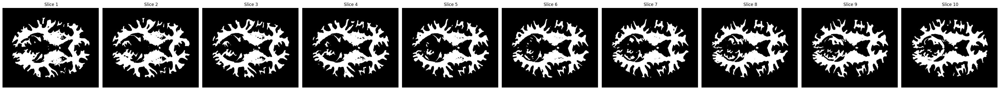

In [116]:
# Get the T1_5 mask (region 5)
T1_5 = (T1_3_4_5 == T1_3_4_5_labels[2]).astype(np.float32)
visualize_row(T1_5, cmap='gray')

## Approach 3 3D (Multi-Otsu Thresholding)

### Step 3: Segmentation of 3,4,5 regions

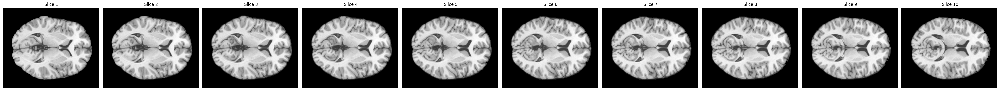

In [117]:
# What we are working with
visualize_row(T1_brain, cmap='gray')

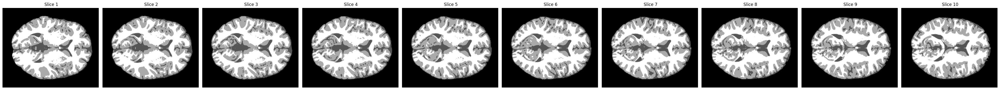

In [ ]:
# Multi-Otsu Thresholding to 3D volume to obtain four (three brain) regions: non-brain (black), 3, 4, 5
T1_3_4_5 = multi_otsu_thresholding(T1_brain, classes=4)
visualize_row(T1_3_4_5, cmap='gray')

In [119]:
# Obtain region masks
T1_3_4_5_labels = np.unique(T1_3_4_5)[1:]

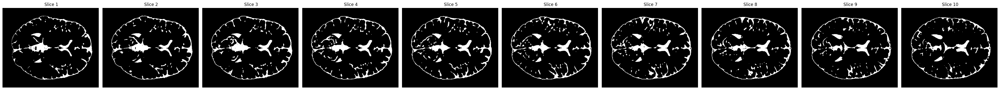

In [120]:
# Get the T1_3 mask (region 3)
T1_3 = (T1_3_4_5 == T1_3_4_5_labels[0]).astype(np.float32)
visualize_row(T1_3, cmap='gray')

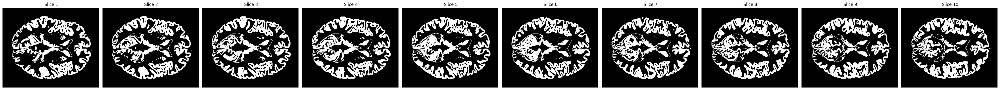

In [121]:
# Get the T1_4 mask (region 4)
T1_4 = (T1_3_4_5 == T1_3_4_5_labels[1]).astype(np.float32)
visualize_row(T1_4, cmap='gray')

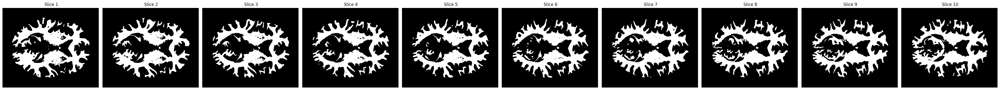

In [122]:
# Get the T1_5 mask (region 5)
T1_5 = (T1_3_4_5 == T1_3_4_5_labels[2]).astype(np.float32)
visualize_row(T1_5, cmap='gray')

## Common 3D (Combination)

### Step 4: Combination of segmented 0,1,2,3,4,5 regions

In [123]:
# Example: Approach 3
# Combine the obtained regions 0, 1, 2, 3, 4, 5
T1_0_1_2_3_4_5_A3_3D = combine_regions(T1_0, T1_1, T1_2, T1_3, T1_4, T1_5)

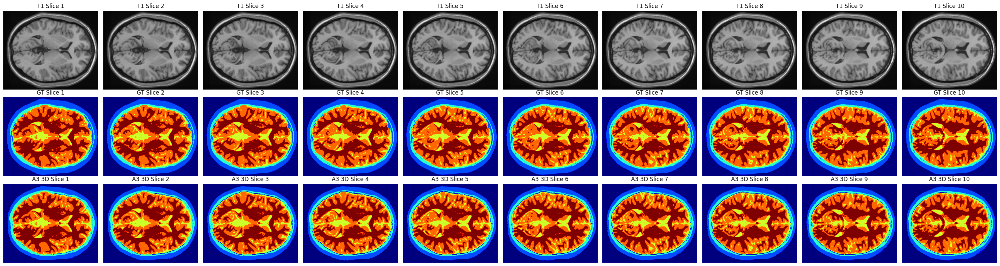

In [124]:
# Example: Approach 3
visualize_rows(T1, GT, T1_0_1_2_3_4_5_A3_3D, 
               cap_1='T1',
               cap_2='GT',
               cap_3='A3 3D',
               cmap_1='gray')